Train a Vision Transformer for small datasets with Reconstructed Images and Latent Images from CVAE

In [1]:
!nvidia-smi

Thu Feb 27 10:17:15 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      Off | 00000000:00:03.0 Off |                    0 |
| N/A   46C    P8              12W /  72W |      1MiB / 23034MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


In [3]:
# Importing libraries
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import LinearSegmentedColormap
import math
import pandas as pd

import tensorflow as tf
import keras
from keras import layers, ops
from keras.models import Model
from tensorflow.keras.optimizers import Adam, AdamW
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image
import cv2

import sklearn.metrics
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve, auc
from sklearn.preprocessing import label_binarize
import seaborn as sns

Data Loading and Preprocessing

In [4]:
base_dir = 'https://console.cloud.google.com/storage/browser/adni-mri-bucket?project=aerial-episode-450709-q1'


In [5]:
from google.cloud import storage

# Initialize the storage client
client = storage.Client()

# Access the bucket
bucket_name = 'adni-mri-bucket'
bucket = client.get_bucket(bucket_name)

In [6]:
# Loading Data

categories = ['CN', 'EMCI', 'MCI', 'LMCI', 'AD']
IMAGE_SIZE = 256
INPUT_SHAPE = (IMAGE_SIZE, IMAGE_SIZE, 1)
NUM_CLASSES = 5

# Function to load and preprocess images from GCP bucket
def load_images_from_bucket(bucket, categories):
    data = []
    labels = []
    for category in categories:
        class_num = categories.index(category)
        # Prefix for the image folder in the bucket
        prefix = f'{category}/'
        blobs = bucket.list_blobs(prefix=prefix)  # List all the images in the category folder

        for blob in blobs:
            try:
                # Download the image as bytes
                img_data = blob.download_as_bytes()
                # Decode the image
                img_array = tf.image.decode_image(img_data, channels=1)
                img_array = tf.image.resize(img_array, [IMAGE_SIZE, IMAGE_SIZE])
                img_array = tf.keras.preprocessing.image.img_to_array(img_array)
                data.append(img_array)
                labels.append(class_num)
            except Exception as e:
                print(f"Error loading image {blob.name}: {e}")
    return np.array(data), np.array(labels)


# Loading data from GCP bucket
x_full, y_full = load_images_from_bucket(bucket, categories)
x_full, y_full = shuffle(x_full, y_full)

# Split data into training and test sets
x_train, x_test, y_train, y_test = train_test_split(x_full, y_full, test_size=0.15, random_state=42)

In [7]:
# Shape of x_train, y_train, x_test, y_test

print(f"x_full shape: {x_full.shape} - y_full shape: {y_full.shape}")
print(f"x_train shape: {x_train.shape} - y_train shape: {y_train.shape}")
print(f"x_test shape: {x_test.shape} - y_test shape: {y_test.shape}")

x_full shape: (14000, 256, 256, 1) - y_full shape: (14000,)
x_train shape: (11900, 256, 256, 1) - y_train shape: (11900,)
x_test shape: (2100, 256, 256, 1) - y_test shape: (2100,)


In [8]:
# Preprocessing function

def preprocess(array):
    """Normalizes the supplied array and reshapes it."""
    array = array.astype("float32") / 255.0
    array = np.reshape(array, (len(array), IMAGE_SIZE, IMAGE_SIZE, 1))
    return array

In [9]:
# Normalizing and reshaping the data

x_train = preprocess(x_train)
x_test = preprocess(x_test)

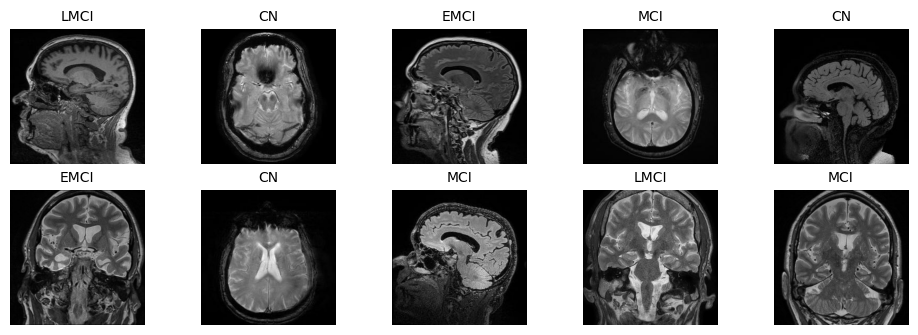

In [10]:
# Displaying the train data
n=5
plt.figure(figsize=(10, 4))

# Plot x_train images

for i in range(n):
    # Display x_train
    ax = plt.subplot(2, n, i + 1)
    plt.imshow(x_train[i], cmap='gray')
    plt.title(f"{categories[y_train[i]]}", fontsize=10)
    plt.axis("off")

# Plot x_test images
for i in range(n):
    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(x_test[i], cmap='gray')
    plt.title(f"{categories[y_test[i]]}", fontsize=10)
    plt.axis("off")

plt.subplots_adjust(left=0.05, right=0.95, top=0.85, wspace=0.4)
plt.show()


CVAE

In [11]:
# Creating a sampling layer for the VAE latent space

# Setting seed for reproducibiltiy
SEED = 42
keras.utils.set_random_seed(SEED)

class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding the image."""

    def __init__(self, **kwargs):
        super().__init__(**kwargs)
        self.seed_generator = keras.random.SeedGenerator(1337)

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = ops.shape(z_mean)[0]
        dim = ops.shape(z_mean)[1]
        epsilon = keras.random.normal(shape=(batch, dim), seed=self.seed_generator)
        return z_mean + ops.exp(0.5 * z_log_var) * epsilon

In [12]:
# Building the CVAE

latent_dim = 64

# Encoder
encoder_inputs = keras.Input(shape=(256, 256, 1))  # Input shape 256x256x1
x = layers.Conv2D(32, 3, activation="relu", strides=2, padding="same")(encoder_inputs)  # Downsample to 128x128x32
x = layers.Conv2D(64, 3, activation="relu", strides=2, padding="same")(x)  # Downsample to 64x64x64
x = layers.Conv2D(128, 3, activation="relu", strides=2, padding="same")(x)  # Downsample to 32x32x128
x = layers.Conv2D(256, 3, activation="relu", strides=2, padding="same")(x)  # Downsample to 16x16x256
x = layers.Conv2D(512, 3, activation="relu", strides=2, padding="same")(x)  # Downsample to 8x8x512
x = layers.Conv2D(1024, 3, activation="relu", strides=2, padding="same")(x)  # Downsample to 4x4x1024

# Variational Encoder component for retrieving latent vector z
x2 = layers.Flatten()(x)  # Flatten to (4*4*1024) = 16384 units
x2 = layers.Dense(512, activation="relu")(x2)  # Dense layer with 512 units

z_mean = layers.Dense(latent_dim, name="z_mean")(x2)  # z_mean for latent space
z_log_var = layers.Dense(latent_dim, name="z_log_var")(x2)  # z_log_var for latent space
z = Sampling()([z_mean, z_log_var])  # Sampling layer using (z_mean, z_log_var)

encoder = keras.Model(encoder_inputs, [z_mean, z_log_var, z], name="encoder")
encoder.summary()


# Decoder
x = layers.Conv2DTranspose(1024, 3, activation="relu", strides=2, padding="same")(x)  # Upsample to 8x8x1024
x = layers.Conv2DTranspose(512, 3, activation="relu", strides=2, padding="same")(x)  # Upsample to 16x16x512
x = layers.Conv2DTranspose(256, 3, activation="relu", strides=2, padding="same")(x)  # Upsample to 32x32x256
x = layers.Conv2DTranspose(128, 3, activation="relu", strides=2, padding="same")(x)  # Upsample to 64x64x128
x = layers.Conv2DTranspose(64, 3, activation="relu", strides=2, padding="same")(x)  # Upsample to 128x128x64
x = layers.Conv2DTranspose(32, 3, activation="relu", strides=2, padding="same")(x)  # Upsample to 256x256x32
x = layers.Conv2DTranspose(1, 3, activation="sigmoid", padding="same")(x)  # Output layer with shape 256x256x1


# Variational Decoder component For Resizing latent vector z for ViT input
latent_inputs = keras.Input(shape=(latent_dim,))  # Latent space input of size 64
x3 = layers.Dense(4 * 4 * 1024, activation="relu")(latent_inputs)  # Dense layer to match the flattened size from encoder
x3 = layers.Reshape((4, 4, 1024))(x3)                               # Reshape to 4x4x1024
x3 = layers.Conv2DTranspose(1024, 3, activation="relu", strides=2, padding="same")(x3)  # Upsample to 8x8x1024
x3 = layers.Conv2DTranspose(512, 3, activation="relu", strides=2, padding="same")(x3)  # Upsample to 16x16x512
x3 = layers.Conv2DTranspose(256, 3, activation="relu", strides=2, padding="same")(x3)  # Upsample to 32x32x256
x3 = layers.Conv2DTranspose(128, 3, activation="relu", strides=2, padding="same")(x3)  # Upsample to 64x64x128
x3 = layers.Conv2DTranspose(64, 3, activation="relu", strides=2, padding="same")(x3)  # Upsample to 128x128x64
x3 = layers.Conv2DTranspose(32, 3, activation="relu", strides=2, padding="same")(x3)  # Upsample to 256x256x32
decoder_outputs = layers.Conv2DTranspose(1, 3, activation="sigmoid", padding="same")(x3)  # Output layer (256x256x1)
decoder = keras.Model(latent_inputs, decoder_outputs, name="decoder")
decoder.summary()

Model: "encoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 256, 256, 1)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, 128, 128, 32)   │            320 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, 64, 64, 64)     │         18,496 │ conv2d[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, 32, 32, 128)    │         73,856 │ conv2d_1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, 16, 16, 256)    │        295,168 │ conv2d_2[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, 8, 8, 512)      │      1,180,160 │ conv2d_3[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, 4, 4, 1024)     │      4,719,616 │ conv2d_4[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 16384)          │              0 │ conv2d_5[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 512)            │      8,389,120 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ z_mean (Dense)            │ (None, 64)             │         32,832 │ dense[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ z_log_var (Dense)         │ (None, 64)             │         32,832 │ dense[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ sampling (Sampling)       │ (None, 64)             │              0 │ z_mean[0][0],          │
│                           │                        │                │ z_log_var[0][0]        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 14,742,400 (56.24 MB)

 Trainable params: 14,742,400 (56.24 MB)

 Non-trainable params: 0 (0.00 B)

Model: "decoder"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 16384)               │       1,064,960 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 4, 4, 1024)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_7 (Conv2DTranspose) │ (None, 8, 8, 1024)          │       9,438,208 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_8 (Conv2DTranspose) │ (None, 16, 16, 512)         │       4,719,104 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_9 (Conv2DTranspose) │ (None, 32, 32, 256)         │       1,179,904 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_10                  │ (None, 64, 64, 128)         │         295,040 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_11                  │ (None, 128, 128, 64)        │          73,792 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_12                  │ (None, 256, 256, 32)        │          18,464 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_13                  │ (None, 256, 256, 1)         │             289 │
│ (Conv2DTranspose)                    │                             │                 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 16,789,761 (64.05 MB)

 Trainable params: 16,789,761 (64.05 MB)

 Non-trainable params: 0 (0.00 B)

Getting Latent Vectors from the Autoencoder

In [13]:
# Defining the CVAE with a custom train_step

class VAE(keras.Model):
    def __init__(self, encoder, decoder, **kwargs):
        super().__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.total_loss_tracker = keras.metrics.Mean(name="total_loss")
        self.reconstruction_loss_tracker = keras.metrics.Mean(
            name="reconstruction_loss"
        )
        self.kl_loss_tracker = keras.metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.reconstruction_loss_tracker,
            self.kl_loss_tracker,
        ]

    def train_step(self, data):
        with tf.GradientTape() as tape:
            z_mean, z_log_var, z = self.encoder(data)
            reconstruction = self.decoder(z)
            reconstruction_loss = ops.mean(
                ops.sum(
                    keras.losses.binary_crossentropy(data, reconstruction),
                    axis=(1, 2),
                )
            )
            kl_loss = -0.5 * (1 + z_log_var - ops.square(z_mean) - ops.exp(z_log_var))
            kl_loss = ops.mean(ops.sum(kl_loss, axis=1))
            total_loss = reconstruction_loss + kl_loss
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        return {
            "loss": self.total_loss_tracker.result(),
            "reconstruction_loss": self.reconstruction_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
        }

In [14]:
# Building and compiling the CVAE
vae = VAE(encoder, decoder)
vae.compile(optimizer=keras.optimizers.Adam())

In [15]:
# Training the CVAE
vae.fit(x_train, epochs=100, batch_size=128)

Epoch 1/100
93/93 ━━━━━━━━━━━━━━━━━━━━ 125s 770ms/step - kl_loss: 3.5343 - loss: 33757.2578 - reconstruction_loss: 33753.7266
Epoch 2/100
93/93 ━━━━━━━━━━━━━━━━━━━━ 25s 264ms/step - kl_loss: 60.8426 - loss: 26013.5762 - reconstruction_loss: 25952.7363
Epoch 3/100
93/93 ━━━━━━━━━━━━━━━━━━━━ 25s 264ms/step - kl_loss: 74.2112 - loss: 24987.2500 - reconstruction_loss: 24913.0449
Epoch 4/100
93/93 ━━━━━━━━━━━━━━━━━━━━ 25s 265ms/step - kl_loss: 80.6671 - loss: 24671.0527 - reconstruction_loss: 24590.3848
Epoch 5/100
93/93 ━━━━━━━━━━━━━━━━━━━━ 25s 264ms/step - kl_loss: 86.4735 - loss: 24501.8047 - reconstruction_loss: 24415.3320
Epoch 6/100
93/93 ━━━━━━━━━━━━━━━━━━━━ 25s 266ms/step - kl_loss: 90.2500 - loss: 24369.6348 - reconstruction_loss: 24279.3867
Epoch 7/100
93/93 ━━━━━━━━━━━━━━━━━━━━ 25s 266ms/step - kl_loss: 94.1364 - loss: 24258.3008 - reconstruction_loss: 24164.1602
Epoch 8/100
93/93 ━━━━━━━━━━━━━━━━━━━━ 25s 266ms/step - kl_loss: 98.5675 - loss: 24126.9902 - reconstruction_loss: 240

66/66 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step


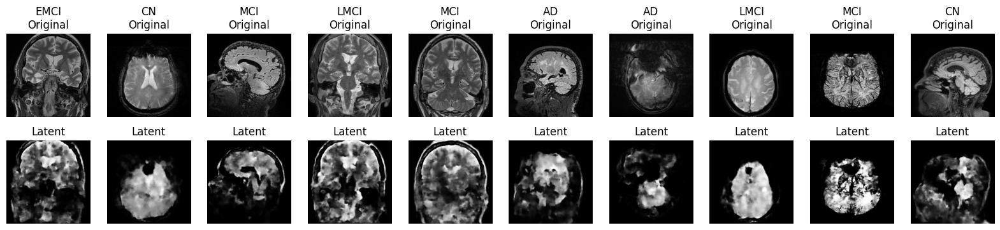

In [127]:
# Evaluating the model on the test set
vae_predictions = vae.decoder.predict(vae.encoder.predict(x_test)[2], verbose=0)

n = 10  # Number of images to display
plt.figure(figsize=(20, 4))

for i in range(n):
    # Display x_test
    ax = plt.subplot(2, n, i + 1)
    plt.imshow((x_test[i] / 255.0))
    plt.gray()
    plt.title(categories[y_test[i]] + "\nOriginal", fontsize=12)
    plt.axis("off")

    # Display latent of x_test
    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(vae_predictions[i])
    plt.gray()
    plt.title("Latent", fontsize=12)
    plt.axis("off")

plt.show()

In [17]:
# Using VAE Encoder, get the latent representations (z) for the x_train dataset
z_mean, z_log_var, z = vae.encoder.predict(x_train, verbose=0)

# Using VAE Decoder, reconstruct the latent vectors (z) to match the image shape
latent_x_train = vae.decoder.predict(z, verbose=0)

In [18]:
z.shape

(11900, 64)

In [19]:
latent_x_train.shape

(11900, 256, 256, 1)

Getting Reconstructed Inputs from the Autoencoder

In [20]:
# Autoencoder for image reconstruction
autoencoder = Model(encoder_inputs, x)

# Compiling the autoencoder
autoencoder.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss="binary_crossentropy",
    metrics=["accuracy"]
)

In [21]:
# Training the autoencoder

autoencoder.fit(
    x=x_train,
    y=x_train,
    epochs=100,
    batch_size=128,
    validation_split=0.1,
)

Epoch 1/100
84/84 ━━━━━━━━━━━━━━━━━━━━ 69s 758ms/step - accuracy: 0.1551 - loss: 0.5138 - val_accuracy: 0.1606 - val_loss: 0.3703
Epoch 2/100
84/84 ━━━━━━━━━━━━━━━━━━━━ 23s 278ms/step - accuracy: 0.1583 - loss: 0.3701 - val_accuracy: 0.1606 - val_loss: 0.3620
Epoch 3/100
84/84 ━━━━━━━━━━━━━━━━━━━━ 24s 281ms/step - accuracy: 0.1583 - loss: 0.3638 - val_accuracy: 0.1606 - val_loss: 0.3584
Epoch 4/100
84/84 ━━━━━━━━━━━━━━━━━━━━ 24s 282ms/step - accuracy: 0.1583 - loss: 0.3603 - val_accuracy: 0.1606 - val_loss: 0.3556
Epoch 5/100
84/84 ━━━━━━━━━━━━━━━━━━━━ 24s 281ms/step - accuracy: 0.1583 - loss: 0.3576 - val_accuracy: 0.1606 - val_loss: 0.3536
Epoch 6/100
84/84 ━━━━━━━━━━━━━━━━━━━━ 24s 281ms/step - accuracy: 0.1583 - loss: 0.3561 - val_accuracy: 0.1606 - val_loss: 0.3525
Epoch 7/100
84/84 ━━━━━━━━━━━━━━━━━━━━ 24s 282ms/step - accuracy: 0.1583 - loss: 0.3545 - val_accuracy: 0.1606 - val_loss: 0.3547
Epoch 8/100
84/84 ━━━━━━━━━━━━━━━━━━━━ 24s 281ms/step - accuracy: 0.1583 - loss: 0.3544 - 

66/66 ━━━━━━━━━━━━━━━━━━━━ 3s 31ms/step


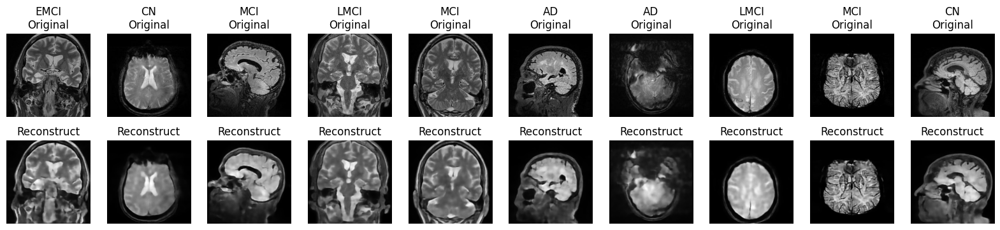

In [22]:
# Evaluating the model on the test set
ae_predictions = autoencoder.predict(x_test)

n = 10  # Number of images to display
plt.figure(figsize=(20, 4))

for i in range(n):
    # Display original x_test
    ax = plt.subplot(2, n, i + 1)
    plt.imshow((x_test[i] / 255.0))
    plt.gray()
    plt.title(categories[y_test[i]] + "\nOriginal", fontsize=12)
    plt.axis("off")

    # Display reconstructed x_test
    ax = plt.subplot(2, n, i + 1 + n)
    plt.imshow(ae_predictions[i])
    plt.gray()
    plt.title("Reconstruct", fontsize=12)
    plt.axis("off")

plt.show()

In [23]:
# Reconstructing x_train

reconstructed_x_train = autoencoder.predict(x_train)
reconstructed_x_train.shape

372/372 ━━━━━━━━━━━━━━━━━━━━ 9s 25ms/step


(11900, 256, 256, 1)

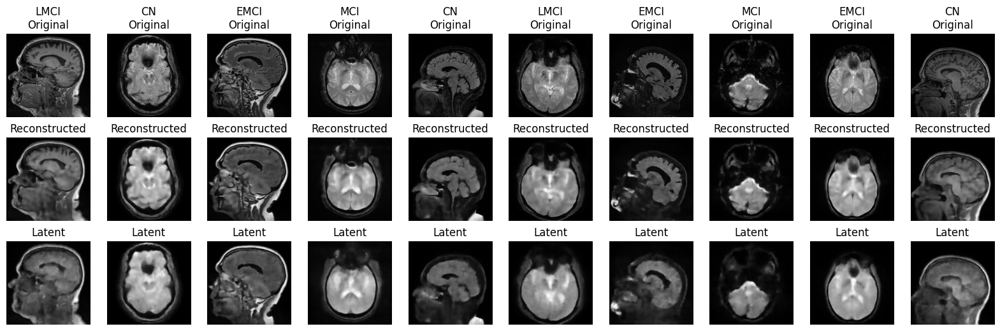

In [24]:
# Displaying the three image sets

n = 10  # Number of images to display
plt.figure(figsize=(20, 6))

for i in range(n):
    # Display original x_train
    ax = plt.subplot(3, n, i + 1)
    plt.imshow((x_train[i] / 255.0))
    plt.title(categories[y_train[i]] + "\nOriginal", fontsize=12)
    plt.axis("off")

    # Display reconstructed x_train
    ax = plt.subplot(3, n, i + 1 + n)
    plt.imshow(reconstructed_x_train[i])
    plt.title("Reconstructed", fontsize=12)
    plt.axis("off")

    # Display latent x_train
    ax = plt.subplot(3, n, i + 1 + 2 * n)
    plt.imshow(latent_x_train[i])
    plt.title("Latent", fontsize=12)
    plt.axis("off")

plt.show()

VIT

In [25]:
# Configuring Hyperparameters

INPUT_SHAPE = (256, 256, 1)

# Augmentation
IMAGE_SIZE = 256
PATCH_SIZE = 16
NUM_PATCHES = (IMAGE_SIZE // PATCH_SIZE) ** 2

# Optimizer
LEARNING_RATE = 0.001
WEIGHT_DECAY = 0.0001

# Training
EPOCHS = 400
BATCH_SIZE = 256
BUFFER_SIZE = 512

# Architecture
LAYER_NORM_EPS = 1e-6
TRANSFORMER_LAYERS = 8
PROJECTION_DIM = 64
NUM_HEADS = 4
TRANSFORMER_UNITS = [
    PROJECTION_DIM * 2,
    PROJECTION_DIM,
]
MLP_HEAD_UNITS = [2048, 1024]

In [26]:
# Data augmentation

data_augmentation = keras.Sequential(
    [
        layers.Normalization(),
        layers.Resizing(IMAGE_SIZE, IMAGE_SIZE),
        layers.RandomFlip("horizontal"),
        layers.RandomRotation(factor=0.02),
        layers.RandomZoom(height_factor=0.2, width_factor=0.2),
    ],
    name="data_augmentation",
)

data_augmentation.layers[0].adapt(reconstructed_x_train)
data_augmentation.layers[0].adapt(latent_x_train)


ViT

In [27]:
# Implementing Shifted Patch Tokenization

class ShiftedPatchTokenization(layers.Layer):
    def __init__(
        self,
        image_size=IMAGE_SIZE,
        patch_size=PATCH_SIZE,
        num_patches=NUM_PATCHES,
        projection_dim=PROJECTION_DIM,
        vanilla=False,
        **kwargs,
    ):
        super().__init__(**kwargs)
        self.vanilla = vanilla  # Flag to swtich to vanilla patch extractor
        self.image_size = image_size
        self.patch_size = patch_size
        self.half_patch = patch_size // 2
        self.flatten_patches = layers.Reshape((num_patches, -1))
        self.projection = layers.Dense(units=projection_dim)
        self.layer_norm = layers.LayerNormalization(epsilon=LAYER_NORM_EPS)

    def crop_shift_pad(self, images, mode):
        # Build the diagonally shifted images
        if mode == "left-up":
            crop_height = self.half_patch
            crop_width = self.half_patch
            shift_height = 0
            shift_width = 0
        elif mode == "left-down":
            crop_height = 0
            crop_width = self.half_patch
            shift_height = self.half_patch
            shift_width = 0
        elif mode == "right-up":
            crop_height = self.half_patch
            crop_width = 0
            shift_height = 0
            shift_width = self.half_patch
        else:
            crop_height = 0
            crop_width = 0
            shift_height = self.half_patch
            shift_width = self.half_patch

        # Crop the shifted images and pad them
        crop = tf.image.crop_to_bounding_box(
            images,
            offset_height=crop_height,
            offset_width=crop_width,
            target_height=self.image_size - self.half_patch,
            target_width=self.image_size - self.half_patch,
        )
        shift_pad = tf.image.pad_to_bounding_box(
            crop,
            offset_height=shift_height,
            offset_width=shift_width,
            target_height=self.image_size,
            target_width=self.image_size,
        )
        return shift_pad

    def call(self, images):
        if not self.vanilla:
            # Concat the shifted images with the original image
            images = tf.concat(
                [
                    images,
                    self.crop_shift_pad(images, mode="left-up"),
                    self.crop_shift_pad(images, mode="left-down"),
                    self.crop_shift_pad(images, mode="right-up"),
                    self.crop_shift_pad(images, mode="right-down"),
                ],
                axis=-1,
            )
        # Patch embed the images and flatten it
        patches = tf.image.extract_patches(
            images=images,
            sizes=[1, self.patch_size, self.patch_size, 1],
            strides=[1, self.patch_size, self.patch_size, 1],
            rates=[1, 1, 1, 1],
            padding="VALID",
        )
        flat_patches = self.flatten_patches(patches)
        if not self.vanilla:
            # Layer normalize the flat patches and linearly project it
            tokens = self.layer_norm(flat_patches)
            tokens = self.projection(tokens)
        else:
            # Linearly project the flat patches
            tokens = self.projection(flat_patches)
        return (tokens, patches)


ORIGINAL


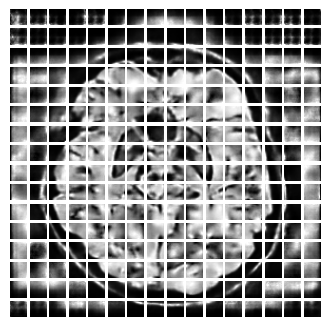

LEFT-UP


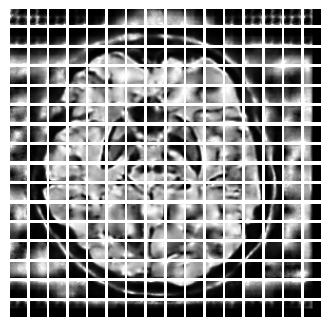

LEFT-DOWN


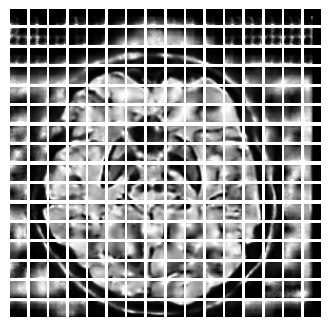

RIGHT-UP


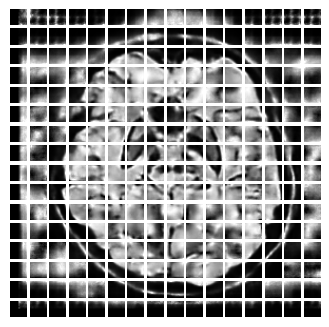

RIGHT-DOWN


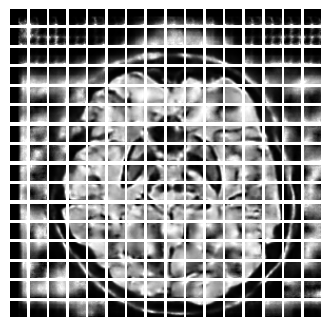

In [28]:
# Visualizing the patches

# Geting a random image and resizing it
image = reconstructed_x_train[np.random.choice(range(reconstructed_x_train.shape[0]))]
resized_image = tf.image.resize(
    tf.convert_to_tensor([image]), size=(IMAGE_SIZE, IMAGE_SIZE)
)

# This takes an image and divides into patches as in the original ViT paper
# (token, patch) = ShiftedPatchTokenization(vanilla=True)(resized_image / 255.0)
# (token, patch) = (token[0], patch[0])
# n = patch.shape[0]
# count = 1
# plt.figure(figsize=(4, 4))
# for row in range(n):
#     for col in range(n):
#         plt.subplot(n, n, count)
#         count = count + 1
#         image = tf.reshape(patch[row][col], (PATCH_SIZE, PATCH_SIZE, 1))  # Grayscale: 1 channel
#         plt.imshow(image)
#         plt.axis("off")
# plt.show()

# Shifted Patch Tokenization: This layer takes the image,
# shifts it diagonally and then extracts patches from the concatinated images
(token, patch) = ShiftedPatchTokenization(vanilla=False)(resized_image / 255.0)
(token, patch) = (token[0], patch[0])
n = patch.shape[0]
shifted_images = ["ORIGINAL", "LEFT-UP", "LEFT-DOWN", "RIGHT-UP", "RIGHT-DOWN"]
for index, name in enumerate(shifted_images):
    print(name)
    count = 1
    plt.figure(figsize=(4, 4))
    for row in range(n):
        for col in range(n):
            plt.subplot(n, n, count)
            count = count + 1
            image = tf.reshape(patch[row][col], (PATCH_SIZE, PATCH_SIZE, 5 * 1))  # Grayscale: 1 channel
            plt.imshow(image[..., index], cmap='gray')  # Plot in grayscale
            plt.axis("off")
    plt.show()


In [29]:
# Implementing the positional embedding on encoded patches

class PatchEncoder(layers.Layer):
    def __init__(
        self, num_patches=NUM_PATCHES, projection_dim=PROJECTION_DIM, **kwargs
    ):
        super().__init__(**kwargs)
        self.num_patches = num_patches
        self.position_embedding = layers.Embedding(
            input_dim=num_patches, output_dim=projection_dim
        )
        self.positions = tf.range(start=0, limit=self.num_patches, delta=1)

    def call(self, encoded_patches):
        encoded_positions = self.position_embedding(self.positions)
        encoded_patches = encoded_patches + encoded_positions
        return encoded_patches


In [30]:
# Implementing Multi-Head Self Attention function - locally inside the Vit Transfomer Encoder

class MultiHeadAttentionLSA(tf.keras.layers.MultiHeadAttention):
    def __init__(self, **kwargs):
        super().__init__(**kwargs)

        # The initial value is the square root of the key dimension.
        self.tau = tf.Variable(math.sqrt(float(self._key_dim)), trainable=True)

    def _compute_attention(self, query, key, value, attention_mask=None, training=None):
        query = tf.multiply(query, 1.0 / self.tau)
        attention_scores = tf.einsum(self._dot_product_equation, key, query)
        attention_scores = self._masked_softmax(attention_scores, attention_mask)
        attention_scores_dropout = self._dropout_layer(
            attention_scores, training=training
        )
        attention_output = tf.einsum(
            self._combine_equation, attention_scores_dropout, value
        )
        return attention_output, attention_scores


In [31]:
# Implementing the MLP function - for Transformer Encoder and final classifier

def mlp(x, hidden_units, dropout_rate):
    for units in hidden_units:
        x = layers.Dense(units, activation=tf.nn.gelu)(x)
        x = layers.Dropout(dropout_rate)(x)
    return x


# Building the diagonal attention mask
diag_attn_mask = 1 - tf.eye(NUM_PATCHES)
diag_attn_mask = tf.cast([diag_attn_mask], dtype=tf.int8)


In [32]:
# Defining the function for the ViT classifier

def create_vit_classifier(vanilla=False):
    inputs = layers.Input(shape=INPUT_SHAPE)

    augmented = data_augmentation(inputs)       # Augmenting data

    (tokens, _) = ShiftedPatchTokenization(vanilla=vanilla)(augmented)      # Creating patches

    encoded_patches = PatchEncoder()(tokens)        # Encoding patches with positions

    # Create multiple layers of the Transformer block
    for _ in range(TRANSFORMER_LAYERS):

        x1 = layers.LayerNormalization(epsilon=1e-6)(encoded_patches)   # Layer normalization 1

        # Creating a multi-head attention layer
        if not vanilla:
            attention_output = MultiHeadAttentionLSA(
                num_heads=NUM_HEADS, key_dim=PROJECTION_DIM, dropout=0.1
            )(x1, x1, attention_mask=diag_attn_mask)
        else:
            attention_output = layers.MultiHeadAttention(
                num_heads=NUM_HEADS, key_dim=PROJECTION_DIM, dropout=0.1
            )(x1, x1)

        # Skip connection 1
        x2 = layers.Add()([attention_output, encoded_patches])

        # Layer normalization 2
        x3 = layers.LayerNormalization(epsilon=1e-6)(x2)

        # MLP
        x3 = mlp(x3, hidden_units=TRANSFORMER_UNITS, dropout_rate=0.1)

        # Skip connection 2
        encoded_patches = layers.Add()([x3, x2])

    # Creating a [batch_size, projection_dim] tensor
    representation = layers.LayerNormalization(epsilon=1e-6)(encoded_patches)
    representation = layers.Flatten()(representation)
    representation = layers.Dropout(0.5)(representation)

    # Adding MLP
    features = mlp(representation, hidden_units=MLP_HEAD_UNITS, dropout_rate=0.5)

    # Dense layer for classifying outputs
    logits = layers.Dense(NUM_CLASSES)(features)

    # Creating the Keras model
    model = keras.Model(inputs=inputs, outputs=logits)

    return model


In [33]:
# Creating the ViT classifier, Compiling and Training the ViT using KFold for cross-validation with 5 folds


# Parameters for K-fold cross-validation
NUM_FOLDS = 5
kf = KFold(n_splits=NUM_FOLDS, shuffle=True, random_state=42)

# Store accuracy for each fold
train_accuracies = []
val_accuracies = []
histories = []


for fold, (train_idx, val_idx) in enumerate(kf.split(latent_x_train, y_train)):
    print(f"\n--- Fold {fold + 1} ---")

    # Split data for the current fold
    x_fold_train_latent, y_fold_train = latent_x_train[train_idx], y_train[train_idx]
    x_fold_val_latent, y_fold_val = latent_x_train[val_idx], y_train[val_idx]

    x_fold_train_reconstructed = reconstructed_x_train[train_idx]
    x_fold_val_reconstructed = reconstructed_x_train[val_idx]

    # Create a new ViT model for each fold (reset weights)
    vit = create_vit_classifier(vanilla=False)

    optimizer = keras.optimizers.AdamW(
        learning_rate=LEARNING_RATE, weight_decay=WEIGHT_DECAY
    )

    vit.compile(
        optimizer,
        loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        metrics=[keras.metrics.SparseCategoricalAccuracy(name="accuracy")],
    )

    # Train the model on latent_x_train
    print("Training on latent_x_train...")
    vit.fit(
        x=x_fold_train_latent,
        y=y_fold_train,
        batch_size=BATCH_SIZE,
        epochs=EPOCHS,
        validation_data=(x_fold_val_latent, y_fold_val),
        verbose=0  # Suppress training output for cleaner logs
    )

    # Train the model on reconstructed_x_train
    print("Training on reconstructed_x_train...")
    history = vit.fit(
        x=x_fold_train_reconstructed,
        y=y_fold_train,
        batch_size=BATCH_SIZE,
        epochs=EPOCHS,
        validation_data=(x_fold_val_reconstructed, y_fold_val),
        verbose=0
    )

    # Store the history object
    histories.append(history.history)

    # Get the final training accuracy from history
    train_accuracy = history.history["accuracy"][-1]  # Last epoch's training accuracy
    train_accuracies.append(train_accuracy)

    # Evaluate on reconstructed_x_train validation set
    val_accuracy = vit.evaluate(x_fold_val_reconstructed, y_fold_val, verbose=0)[1]
    val_accuracies.append(val_accuracy)

    print(f"Training Accuracy for Fold {fold + 1}: {train_accuracy:.4f}")
    print(f"Validation Accuracy for Fold {fold + 1}: {val_accuracy:.4f}")

# Report final cross-validation results
mean_train_accuracy = np.mean(train_accuracies)
std_dev_train_accuracy = np.std(train_accuracies)
mean_val_accuracy = np.mean(val_accuracies)
std_dev_val_accuracy = np.std(val_accuracies)

print("\nCross-Validation Results:")
print(f"\nCross-Validation Mean Training Accuracy: {mean_train_accuracy:.4f}")
print(f"Cross-Validation Training Accuracy Standard Deviation: {std_dev_train_accuracy:.4f}")
print(f"Cross-Validation Mean Validation Accuracy: {mean_val_accuracy:.4f}")
print(f"Cross-Validation Validation Accuracy Standard Deviation: {std_dev_val_accuracy:.4f}")



--- Fold 1 ---
Training on latent_x_train...
Training on reconstructed_x_train...
Training Accuracy for Fold 1: 0.9707
Validation Accuracy for Fold 1: 0.9500

--- Fold 2 ---
Training on latent_x_train...
Training on reconstructed_x_train...
Training Accuracy for Fold 2: 0.9728
Validation Accuracy for Fold 2: 0.9504

--- Fold 3 ---
Training on latent_x_train...
Training on reconstructed_x_train...
Training Accuracy for Fold 3: 0.9726
Validation Accuracy for Fold 3: 0.9555

--- Fold 4 ---
Training on latent_x_train...
Training on reconstructed_x_train...
Training Accuracy for Fold 4: 0.9751
Validation Accuracy for Fold 4: 0.9563

--- Fold 5 ---
Training on latent_x_train...
Training on reconstructed_x_train...
Training Accuracy for Fold 5: 0.9755
Validation Accuracy for Fold 5: 0.9475

Cross-Validation Results:

Cross-Validation Mean Training Accuracy: 0.9733
Cross-Validation Training Accuracy Standard Deviation: 0.0018
Cross-Validation Mean Validation Accuracy: 0.9519
Cross-Validation 

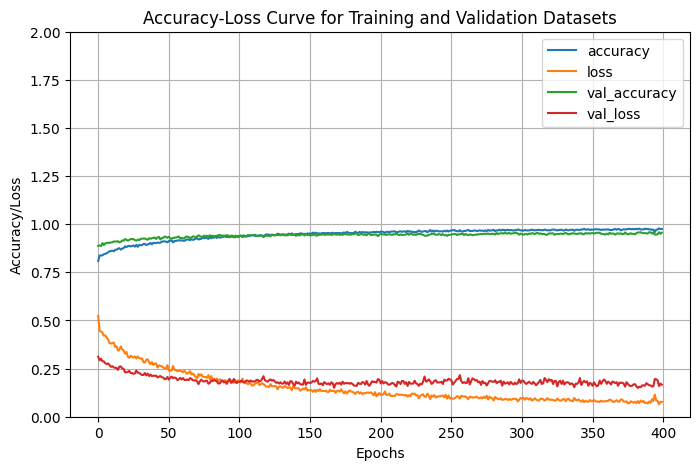

In [34]:
# Accuracy/Loss Curve

fold_idx = 3
history = histories[fold_idx]

pd.DataFrame(history).plot(figsize=(8, 5))
plt.grid(True)
plt.gca().set_ylim(0, 2)
plt.xlabel('Epochs')
plt.ylabel('Accuracy/Loss')
plt.title('Accuracy-Loss Curve for Training and Validation Datasets')
plt.show()

In [35]:
# Evaluating the model on the test set

# Accuracy and loss for the test dataset
test_loss, test_acc = vit.evaluate(x_test, y_test)

print('\nAccuracy for Test Dataset: %.4f' % test_acc)
print('\nLoss for Test Dataset: %.4f' % test_loss)

66/66 ━━━━━━━━━━━━━━━━━━━━ 3s 20ms/step - accuracy: 0.9299 - loss: 0.2678

Accuracy for Test Dataset: 0.9329

Loss for Test Dataset: 0.2402


In [36]:
# Getting predictions for test data (getting the highest probability class)

y_pred_probs = vit.predict(x_test)
y_pred = np.argmax(y_pred_probs, axis=-1)

66/66 ━━━━━━━━━━━━━━━━━━━━ 3s 35ms/step



Classification Report: 
               precision    recall  f1-score   support

          CN       0.96      0.92      0.94       443
        EMCI       0.93      0.96      0.94       377
         MCI       0.89      0.94      0.92       434
        LMCI       0.96      0.92      0.94       425
          AD       0.93      0.92      0.92       421

    accuracy                           0.93      2100
   macro avg       0.93      0.93      0.93      2100
weighted avg       0.93      0.93      0.93      2100



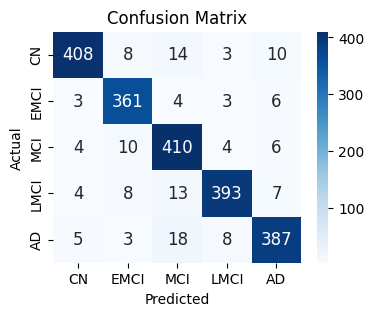

In [37]:
# Classification report
print("\nClassification Report: \n", classification_report(y_test, y_pred, target_names=categories))

# Confusion matrix
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(4, 3))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', annot_kws={"size": 12}, xticklabels=categories, yticklabels=categories)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

In [38]:
# Compute Sensitivity and Specificity from confusion matrix

# Initialize lists to store results
sensitivity = []
specificity = []

# Calculate metrics for each class
for i in range(len(categories)):
    TP = cm[i, i]
    FN = np.sum(cm[i, :]) - TP
    FP = np.sum(cm[:, i]) - TP
    TN = np.sum(cm) - (TP + FN + FP)

    sens = TP / (TP + FN) if (TP + FN) > 0 else 0
    spec = TN / (TN + FP) if (TN + FP) > 0 else 0

    sensitivity.append(sens)
    specificity.append(spec)

# Display results
for idx, category in enumerate(categories):
    print(f"{category} - Sensitivity: {sensitivity[idx]:.2f}, Specificity: {specificity[idx]:.2f}")

CN - Sensitivity: 0.92, Specificity: 0.99
EMCI - Sensitivity: 0.96, Specificity: 0.98
MCI - Sensitivity: 0.94, Specificity: 0.97
LMCI - Sensitivity: 0.92, Specificity: 0.99
AD - Sensitivity: 0.92, Specificity: 0.98


In [39]:
# AUC-ROC Curve

# Convert y_test to a one-hot encoding
y_test_binarized = label_binarize(y_test, classes=[0, 1, 2, 3, 4])

# Calculate AUC for each class
auc_values = []
for i in range(y_test_binarized.shape[1]):
    auc = roc_auc_score(y_test_binarized[:, i], y_pred_probs[:, i])
    auc_values.append(auc)

# Display per-class AUC
for class_idx, auc_val in enumerate(auc_values):
    print(f"AUC for class {class_idx}: {auc:.4f}")

# Optionally calculate the macro-average AUC
macro_auc = np.mean(auc_values)
print(f"Macro-average AUC: {macro_auc:.4f}")


AUC for class 0: 0.9905
AUC for class 1: 0.9905
AUC for class 2: 0.9905
AUC for class 3: 0.9905
AUC for class 4: 0.9905
Macro-average AUC: 0.9903


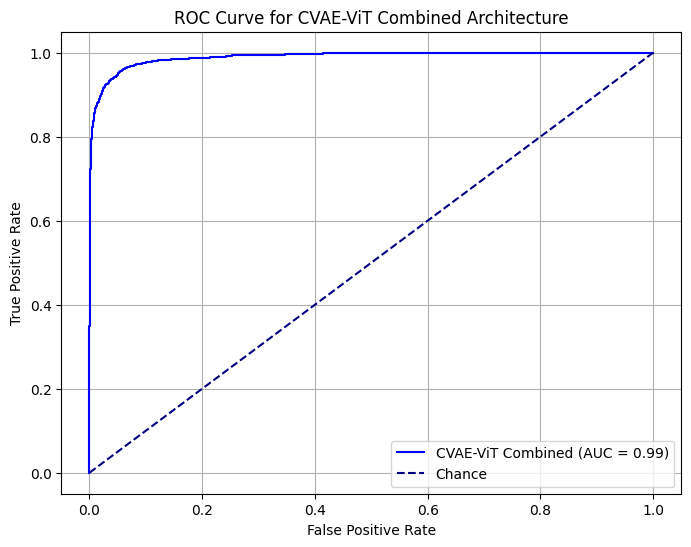

In [40]:
from sklearn.metrics import auc

# Calculate ROC and AUC for the model
fpr_d, tpr_d, _ = roc_curve(y_test_binarized.ravel(), y_pred_probs.ravel())
auc_d = auc(fpr_d, tpr_d)


# Plot the ROC curves
plt.figure(figsize=(8, 6))
plt.plot(fpr_d, tpr_d, color="blue", label=f"CVAE-ViT Combined (AUC = {auc_d:.2f})")

# Add a diagonal line for reference
plt.plot([0, 1], [0, 1], color="navy", linestyle="--", label="Chance")

# Add labels, legend, and title
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve for CVAE-ViT Combined Architecture")
plt.legend(loc="lower right")
plt.grid()

# Show the plot
plt.show()

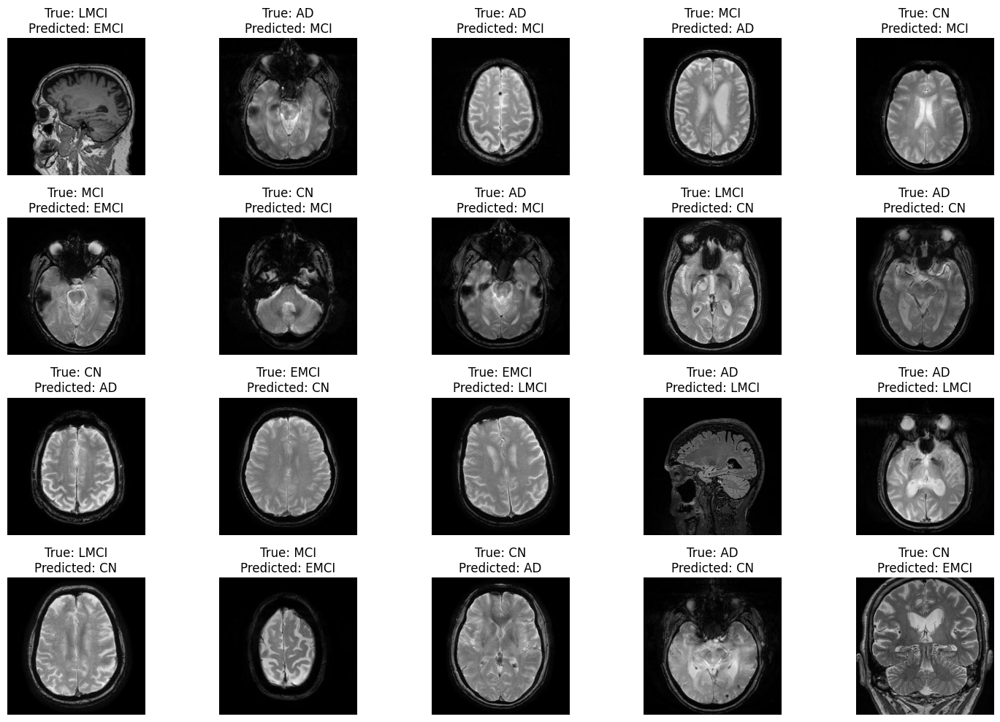

In [41]:
# Displaying the first 20 incorrect predictions

# Finding indices of incorrect predictions
incorrect_indices = np.where(y_pred != y_test)[0]

# Displaying the incorrect predictions
num_incorrect_to_display = min(20, len(incorrect_indices))

plt.figure(figsize=(15, 10))
for i, incorrect_idx in enumerate(incorrect_indices[:num_incorrect_to_display]):
    plt.subplot(4, 5, i + 1)
    plt.imshow(x_test[incorrect_idx])
    plt.title(f"True: {categories[y_test[incorrect_idx]]}\nPredicted: {categories[y_pred[incorrect_idx]]}")
    plt.axis('off')

plt.tight_layout()
plt.show()

In [42]:
from google.colab import files

# Save the model temporarily in Colab
model_path = "/content/ViT_CVAE_latentandreconstruct.keras"
vit.save(model_path)

# Download the saved model
files.download(model_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Visualizing Grad-CAM Heatmaps

In [46]:
vit.summary()

Model: "functional_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_8             │ (None, 256, 256, 1)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ data_augmentation         │ (None, 256, 256, 1)    │              3 │ input_layer_8[0][0]    │
│ (Sequential)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ shifted_patch_tokenizati… │ [(None, 256, 64),      │         84,544 │ data_augmentation[5][… │
│ (ShiftedPatchTokenizatio… │ (None, 16, 16, 1280)]  │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ patch_encoder_5           │ (None, 256, 64)        │         16,384 │ shifted_patch_tokeniz… │
│ (PatchEncoder)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ layer_normalization_92    │ (None, 256, 64)        │            128 │ patch_encoder_5[0][0]  │
│ (LayerNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention_lsa… │ (None, 256, 64)        │         66,368 │ layer_normalization_9… │
│ (MultiHeadAttentionLSA)   │                        │                │ layer_normalization_9… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_80 (Add)              │ (None, 256, 64)        │              0 │ multi_head_attention_… │
│                           │                        │                │ patch_encoder_5[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ layer_normalization_93    │ (None, 256, 64)        │            128 │ add_80[0][0]           │
│ (LayerNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_104 (Dense)         │ (None, 256, 128)       │          8,320 │ layer_normalization_9… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_136 (Dropout)     │ (None, 256, 128)       │              0 │ dense_104[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_105 (Dense)         │ (None, 256, 64)        │          8,256 │ dropout_136[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_137 (Dropout)     │ (None, 256, 64)        │              0 │ dense_105[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_81 (Add)              │ (None, 256, 64)        │              0 │ dropout_137[0][0],     │
│                           │                        │                │ add_80[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ layer_normalization_94    │ (None, 256, 64)        │            128 │ add_81[0][0]           │
│ (LayerNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multi_head_attention_

 Total params: 36,426,440 (138.96 MB)

 Trainable params: 36,426,437 (138.96 MB)

 Non-trainable params: 3 (16.00 B)

In [50]:
# Print all layers in the ViT model to inspect the names
for layer in vit.layers:
    print(layer.name)

input_layer_8
data_augmentation
shifted_patch_tokenization_6
patch_encoder_5
layer_normalization_92
multi_head_attention_lsa_40
add_80
layer_normalization_93
dense_104
dropout_136
dense_105
dropout_137
add_81
layer_normalization_94
multi_head_attention_lsa_41
add_82
layer_normalization_95
dense_106
dropout_139
dense_107
dropout_140
add_83
layer_normalization_96
multi_head_attention_lsa_42
add_84
layer_normalization_97
dense_108
dropout_142
dense_109
dropout_143
add_85
layer_normalization_98
multi_head_attention_lsa_43
add_86
layer_normalization_99
dense_110
dropout_145
dense_111
dropout_146
add_87
layer_normalization_100
multi_head_attention_lsa_44
add_88
layer_normalization_101
dense_112
dropout_148
dense_113
dropout_149
add_89
layer_normalization_102
multi_head_attention_lsa_45
add_90
layer_normalization_103
dense_114
dropout_151
dense_115
dropout_152
add_91
layer_normalization_104
multi_head_attention_lsa_46
add_92
layer_normalization_105
dense_116
dropout_154
dense_117
dropout_155


In [454]:
# Compute Grad-CAM
def get_grad_cam_for_vit(model, img_array, class_idx, layer_name):
    # Watch the gradients
    with tf.GradientTape() as tape:
            # Cast to float32 to ensure compatibility
            img_tensor = tf.cast(img_array, tf.float32)
            # Get the attention output and model prediction
            attn_output, predictions = grad_model(img_tensor)
            # Get the score for the target class
            class_output = predictions[:, class_idx]

    # Calculate gradients of the target class with respect to the attention output
    grads = tape.gradient(class_output, attn_output)

        # Handle different attention output formats
        # If the attention output is 3D (batch, sequence_length, features)
    if len(attn_output.shape) == 3:
            # Pool the gradients over the feature dimension
            pooled_grads = tf.reduce_mean(grads, axis=2)
            # Weight the attention by the gradients
            weighted_attn = tf.multiply(pooled_grads[:, :, tf.newaxis], attn_output)
            # Take the mean over the feature dimension
            attn_map = tf.reduce_mean(weighted_attn, axis=2).numpy()[0]

            # Reshape to spatial dimensions
            height, width = img_array.shape[1:3]

            # For ViT models, the sequence typically includes a class token and then patch tokens
            # Try to determine patch size based on sequence length and image dimensions
            seq_length = attn_map.shape[0]

            # If we have a class token, remove it
            if (height * width) / (seq_length - 1) > 0.5:  # Heuristic to check if there's a class token
                attn_map = attn_map[1:]  # Remove class token
                seq_length = seq_length - 1

            # Estimate patch size
            patch_size = int(np.sqrt((height * width) / seq_length))
            h_patches = height // patch_size
            w_patches = width // patch_size

            # Try to reshape the attention map to spatial dimensions
            try:
                if seq_length == h_patches * w_patches:
                    attn_map = attn_map.reshape(h_patches, w_patches)
                else:
                    # If dimensions don't match, resize directly
                    attn_map = np.resize(attn_map, (h_patches, w_patches))
            except:
                # Fallback: just resize to the image dimensions
                attn_map = np.resize(attn_map, (height // 16, width // 16))  # ViT patch size is 16

        # If the attention output has a different shape (e.g., 4D for multi-head attention)
    elif len(attn_output.shape) == 4:
            # Average over the heads dimension
            attn_map = tf.reduce_mean(attn_output, axis=[1, 3]).numpy()[0]
    else:
            # Fallback for other shapes
            attn_map = tf.reduce_mean(attn_output, axis=-1).numpy()[0]

        # Resize the attention map to the input image size
    attn_map = cv2.resize(attn_map, (img_array.shape[2], img_array.shape[1]))

    # Normalize the heatmap
    # heatmap = np.maximum(attn_map, 0) / (np.max(attn_map) + 1e-10)

    # Normalize the heatmap
    heatmap = np.maximum(attn_map, 0)
    heatmap /= np.max(attn_map)
    heatmap = np.squeeze(heatmap)

    return heatmap

In [455]:
# Superimpose the heatmap on original image
def visualize_grad_cam_for_classes(img, heatmap):
      # Rescale the heatmap to a range 0-255
      heatmap = np.uint8(255 * heatmap)

      # Use jet colormap to colorize the heatmap
      jet = plt.get_cmap('jet')
      jet_colors = jet(np.arange(256))[:, :3]
      jet_heatmap = jet_colors[heatmap]

      # Create an image with RGB colorized heatmap
      jet_heatmap = image.array_to_img(jet_heatmap)
      jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
      jet_heatmap = image.img_to_array(jet_heatmap)

      # Superimpose the heatmap on original image
      superimposed_img = jet_heatmap * 0.4 + img
      superimposed_img = image.array_to_img(superimposed_img)

      return superimposed_img

In [456]:
def mask_heatmap(img):

    # Dynamic threshold based on the image's intensity range
    min_val, max_val = np.min(img), np.max(img)
    threshold_value = (max_val - min_val) * 0.1 + min_val

    # Apply thresholding dynamically
    _, thresh = cv2.threshold(img, threshold_value, 255, cv2.THRESH_BINARY)

    # Apply morphological operations to clean up the mask
    kernel = np.ones((5, 5), np.uint8)
    thresh_clean = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

    refined_mask = cv2.morphologyEx(thresh_clean, cv2.MORPH_OPEN, kernel)

    # Ensure the mask has the correct data type
    refined_mask = np.uint8(refined_mask)

    # Normalize and visualize the masked heatmap
    masked_heatmap = np.maximum(refined_mask, 0) / (np.max(refined_mask) + 1e-10)

    # return stripped_img
    return masked_heatmap

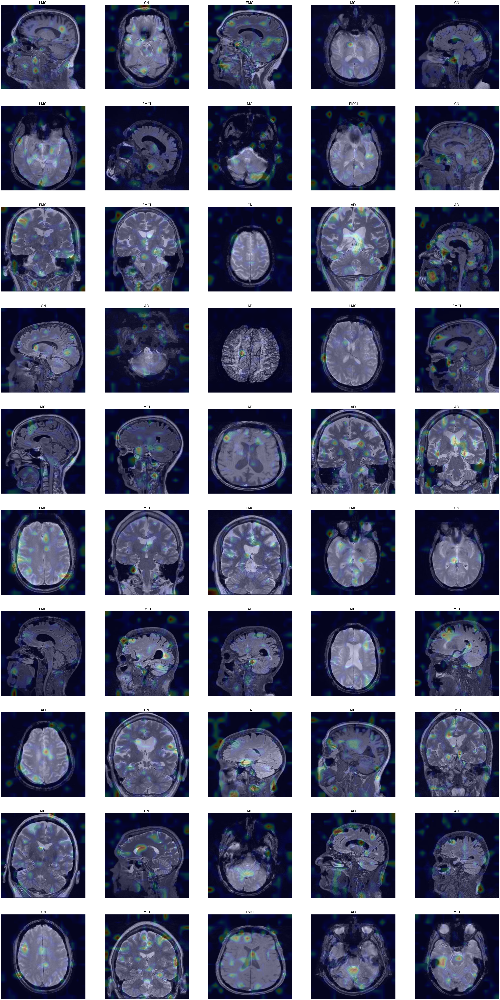



In these heatmaps, the red and yellow regions indicate the areas where the model focused most. 
These regions are likely to contain features that influenced the model's prediction. 


In [457]:

model = vit
last_attn_layer = 'multi_head_attention_lsa_46'

# Create a model that outputs both the activations of the specified layer and the predictions
grad_model = Model(
       inputs=model.inputs,
       outputs=[model.get_layer(last_attn_layer).output, model.output]
)

# Loop through x_test[0] to x_test[2]
plt.figure(figsize=(50, 100))  # Create one figure for all images - Width, Height
for i in range(50):

    # Load the test image
    img = x_train[i]
    img_arr = image.img_to_array(img)

    # Remove last channel if it's grayscale
    img_2d = img.squeeze(axis=-1)
    x = image.img_to_array(img_2d)
    x = np.expand_dims(x, axis=0)   # Expand dimensions to match model input

    # Generate the Grad-CAM heatmap
    heatmap = get_grad_cam_for_vit(model, x, y_test[i], last_attn_layer)

    # Superimpose the heatmap on original image
    superimposed_img = visualize_grad_cam_for_classes(img_arr, heatmap)

    # Apply the skull mask (ensuring only the skull is highlighted)
    masked_heatmap = mask_heatmap(img_arr)

    # Display results
    plt.subplot(10, 5, i+1)

    # Display the heatmaps
    plt.imshow(masked_heatmap, cmap='grey', alpha=0.8)
    plt.imshow(superimposed_img, alpha=0.7)
    plt.imshow(img_arr, alpha=0.7)
    plt.axis('off')
    plt.title(f"{categories[y_train[i]]}", fontsize=20)


plt.show()


# Interpretation
print("\n\nIn these heatmaps, the red and yellow regions indicate the areas where the model focused most. "
      "\nThese regions are likely to contain features that influenced the model's prediction. ")


